# Point Cloud를 활용한 방 꼭짓점 보정 알고리즘

In [1]:
import json
import numpy as np
import matplotlib.pyplot as plt

In [2]:
pointcloud_path = "room_coner5.json"

## Depth 이미지 테스트

### Camera Calibration
##### pixel coordinates -> world coordinates로 변환하는 과정
##### world 좌표계로 변환하여 키포인트의 실제 3차원 길이 계산

In [3]:

def get_world_xyz_array(pointcloud_path):

    with open(pointcloud_path) as f:
        depth_json = json.load(f)
    depth_values = depth_json["Depth"]
    depth_w = 256
    depth_h = 192
    fl_x = depth_json['fl']['x']
    fl_y = depth_json['fl']['y']
    xyz_array = []
    
    k = 0
    for i in range(depth_h):
        for j in range(depth_w):
            z = depth_values[k]
            x = (j - 256 / 2) * z / (fl_x / 7.5)
            y = (i - 192 / 2) * z / (fl_y / 7.5)
            xyz_array.append([x, y, z])
            k += 1

    R_camera_to_world = np.array([[depth_json['m00'], depth_json['m01'], depth_json['m02'], depth_json['m03']],
                                  [depth_json['m10'], depth_json['m11'], depth_json['m12'], depth_json['m13']],
                                  [depth_json['m20'], depth_json['m21'], depth_json['m22'], depth_json['m23']],
                                  [depth_json['m30'], depth_json['m31'], depth_json['m32'], depth_json['m33']]])

    R_camera_to_world = R_camera_to_world[0:3, 0:3]

    T_camera_to_world  = np.array([depth_json['Pos']['x'], depth_json['Pos']['y'], depth_json['Pos']['z']])

    world_xyz = np.dot(xyz_array, R_camera_to_world) + T_camera_to_world

    world_xyz_array = world_xyz.reshape((192, 256, 3))
    world_xyz_array = np.rot90(world_xyz_array, k=-1)

    return world_xyz_array

### depth 이미지 길이 측정
##### 두 키포인트의 실제 길이 측정

두 점 사이의 거리: 239.61748164044425 cm


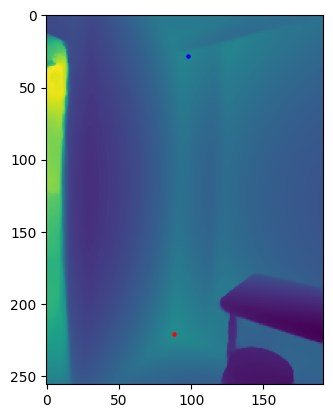

In [4]:
import numpy as np
import matplotlib.pyplot as plt

# 1. 월드 좌표계 포인트 클라우드 배열 생성
world_xyz_array = get_world_xyz_array(pointcloud_path)

# 2. 월드 좌표계의 거리 맵 시각화
plt.imshow(np.sqrt(world_xyz_array[:, :, 0]**2 + 
                   world_xyz_array[:, :, 1]**2 + 
                   world_xyz_array[:, :, 2]**2))

# 3. 두 점의 좌표 정의
x = [88, 98]
y = [221, 28]

# 4. 점을 작은 크기로 표시 (s 매개변수로 크기 조절)
plt.scatter(x[0], y[0], s=5, color='red')  # s: 점 크기 (10 픽셀)
plt.scatter(x[1], y[1], s=5, color='blue')

# 5. 두 점 사이 거리 계산 및 출력
dist2 = np.linalg.norm(world_xyz_array[y[0], x[0]] - world_xyz_array[y[1], x[1]]) * 100
print(f"두 점 사이의 거리: {dist2} cm")

# 6. 시각화 출력
plt.show()


## Point Cloud 계산

### Point Cloud 만들기
##### depth 값을 Point Cloud 데이터로 변환하여 Open3d로 실제 길이 계산 및 키포인트 보정 

#### depth map 이랑 매칭하기 위해서 해야 하는 것

In [5]:
pcd =[]

with open (pointcloud_path, "r") as f:
    depth_json = json.load(f)
    # depth_w = depth_json['Width']
    # depth_h = depth_json['Height']
    depth_w = 256
    depth_h = 192
    fl_x = depth_json["fl"]["x"]
    fl_y = depth_json["fl"]["y"]
    rgb_depth_ratio = 7.5

    camera_depth_array = np.zeros((depth_w, depth_h), dtype=np.float64)
    for i in range(len(depth_json['Depth'])):
        x=i%depth_w
        y=i//depth_w
        camera_depth_array[x][y] = depth_json['Depth'][i]


    camera_xyz_array = []

    # 거리를 실측할 수 있는 world_xyz_array를 만들기 전에 먼저 camera_xyz_array를 만든다.

    for i in range(depth_w):
        for j in range(depth_h):
            z = camera_depth_array[i][j]
            x = (j - 256 / 2) * z / (fl_x / rgb_depth_ratio)
            y = (i - 192 / 2) * z / (fl_y / rgb_depth_ratio)
            pcd.append([x, y, z])


pcd_true = np.array(pcd, dtype=np.float32)

#### 3차원 시각화할때 하고 싶은 것

In [6]:
pcd =[]

with open (pointcloud_path, "r") as f:
    depth_json = json.load(f)

    depth_w = 256
    depth_h = 192
    fl_x = depth_json["fl"]["x"]
    fl_y = depth_json["fl"]["y"]
    rgb_depth_ratio = 7.5

    camera_depth_array = np.zeros((depth_w, depth_h), dtype=np.float64)
    for i in range(len(depth_json['Depth'])):
        x=i%depth_w
        y=i//depth_w
        camera_depth_array[x][y] = depth_json['Depth'][i]


    camera_xyz_array = []

    # 거리를 실측할 수 있는 world_xyz_array를 만들기 전에 먼저 camera_xyz_array를 만든다.
    # height부터 채우느냐, i부터 채우느냐에 따라 마지막 world_xyz_array가 달라질 수 있다.
    # 현재 (24. 04. 18) 반팔 옷에 대해 테스트할 때는 height부터 채워야 실측이 제대로 된다.
    for i in range(depth_w):
        for j in range(depth_h):
            z = camera_depth_array[i][j]
            x = -(i - depth_w / 2) * z / (fl_x / rgb_depth_ratio)
            y = -(j - depth_h / 2) * z / (fl_y / rgb_depth_ratio)
            pcd.append([x, y, z])


pcd_true = np.array(pcd, dtype=np.float32)

In [7]:
pcd_true.shape

(49152, 3)

In [8]:
from plyfile import PlyData
from pyntcloud import PyntCloud
import pandas as pd

point_cloud = {'x': pcd_true[:, 0],
       'y': pcd_true[:, 1],
       'z': pcd_true[:, 2]
       }
# build a cloud
cloud = PyntCloud(pd.DataFrame(point_cloud))
ply_path = "new_ply_10.ply"
cloud.to_file(ply_path, as_text=True)

### Point Cloud 시각화
##### 실제 3차원 좌표 시각화
##### 원격 서버 -> draw_plotly로 진행

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


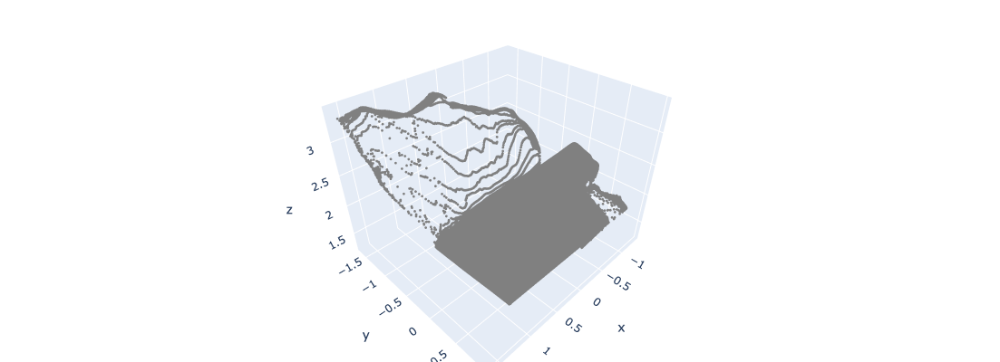

In [9]:
import open3d as o3d

pcd = o3d.io.read_point_cloud(ply_path)
pcd.paint_uniform_color([0.5, 0.5, 0.5])  # 회색

o3d.visualization.draw_plotly([pcd])

### 코너 보정 알고리즘
##### 키포인트 주변 3개의 평면을 찾아 3개의 평면이 만나는 꼭짓점으로 키포인트를 보정하는 알고리즘

In [10]:
'''
- 2차원 RGB 이미지로 찾은 키포인트를 point cloud 좌표와 매칭
- 2차원 keypoint의 point cloud 좌표 주변으로 1000개의 point 반환
- 1000개의 point에 대해 RANSAC 알고리즘으로 3개의 평면을 찾고 평면 방정식 추정
- 3개의 평면 방정식으로 꼭짓점을 구하고 꼭짓점으로 키포인트를 보정
'''



# 평면 탐지 함수 정의 (RANSAC)
def detect_planes(neighbors):
    planes = []
    models = []  # 평면 방정식 저장

    remaining_points = neighbors

    # 3개의 평면 찾기
    for i in range(3):
        plane_model, inliers = remaining_points.segment_plane(
            distance_threshold=0.01, ransac_n=3, num_iterations=1000
        )
        plane_points = remaining_points.select_by_index(inliers)
        planes.append(plane_points)
        models.append(plane_model)  # 평면 방정식 저장

        remaining_points = remaining_points.select_by_index(inliers, invert=True)
        print(f"평면 {i+1} 탐지 완료: 법선 벡터 = {plane_model[:3]}")

    return planes, models


# 세 평면의 교차점 계산
def find_intersection(planes):
    A = np.array([plane[:3] for plane in planes])  # 평면의 법선 벡터들
    B = np.array([-plane[3] for plane in planes])  # 상수 항들
    return np.linalg.solve(A, B)  # 선형 방정식 풀이


# 평면, 교차점 Return 
def adjust_coordinates(ply_path, keypoint):
    pcd = o3d.io.read_point_cloud(ply_path)
    pcd_tree = o3d.geometry.KDTreeFlann(pcd)
    [_, idx, _] = pcd_tree.search_knn_vector_3d(keypoint, 1000)  # KNN으로 근처 point 1000개 반환
    neighbors = pcd.select_by_index(idx)
    
    planes, models = detect_planes(neighbors)
    intersection = find_intersection(models)
    print(f"세 평면이 만나는 교차점: {intersection}")
    return planes, intersection


평면 1 탐지 완료: 법선 벡터 = [-0.04943391  0.44700758  0.89316321]
평면 2 탐지 완료: 법선 벡터 = [-0.01609416  0.82555274 -0.56409542]
평면 3 탐지 완료: 법선 벡터 = [ 0.99584017  0.03501968 -0.08411888]
세 평면이 만나는 교차점: [-1.21140961 -0.09162346  2.49301875]
평면 1 탐지 완료: 법선 벡터 = [0.06996486 0.50492288 0.86032424]
평면 2 탐지 완료: 법선 벡터 = [-0.10567409  0.79009479 -0.60380726]
평면 3 탐지 완료: 법선 벡터 = [-0.04254081  0.40933918  0.91138999]
세 평면이 만나는 교차점: [2.3805157  0.05101456 2.20245223]
두 점 사이의 거리 :  2.3947396
두 점 사이의 보정된 거리 :  2.421431382526757
두 점 사이의 실제 거리 : 2.45 


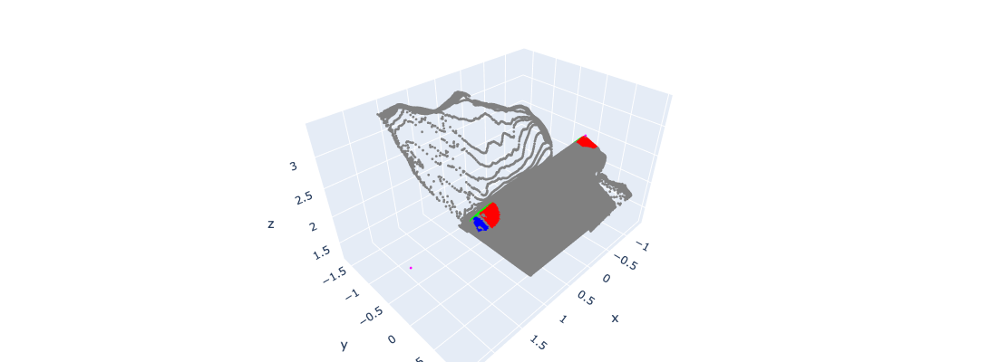

In [11]:
import open3d as o3d
import numpy as np


k1 = pcd_true[221*192 + 104]
keypoint1 = o3d.geometry.PointCloud()
keypoint1.points = o3d.utility.Vector3dVector([k1])
keypoint1.paint_uniform_color([1, 0, 0])  

planes1, intersection_1 = adjust_coordinates(ply_path, k1)
intersection_point_1 = o3d.geometry.PointCloud()
intersection_point_1.points = o3d.utility.Vector3dVector([intersection_1])
intersection_point_1.paint_uniform_color([1, 0, 1])  




k2 = pcd_true[28*192 + 94]    # point cloud 좌표의 점 찾기 (y*192 + x)
keypoint2 = o3d.geometry.PointCloud()
keypoint2.points = o3d.utility.Vector3dVector([k2])
keypoint2.paint_uniform_color([1, 0, 0])

planes2, intersection_2 = adjust_coordinates(ply_path, k2)    # 3개 평면, 교차점
intersection_point_2 = o3d.geometry.PointCloud()
intersection_point_2.points = o3d.utility.Vector3dVector([intersection_2])
intersection_point_2.paint_uniform_color([1, 0, 1])  


distance = np.linalg.norm(k1 - k2)
distance_fixed = np.linalg.norm(intersection_1 - k2)
print("두 점 사이의 거리 : ", distance)
print("두 점 사이의 보정된 거리 : ", distance_fixed)
print("두 점 사이의 실제 거리 : 2.45 ")



# 3개의 평면 색 선정
colors = [[1, 0, 0], [0, 1, 0], [0, 0, 1]]  
for i, plane1 in enumerate(planes1):
    plane1.paint_uniform_color(colors[i])

for i, plane2 in enumerate(planes2):
    plane2.paint_uniform_color(colors[i])


# 8. 원본 포인트 클라우드 색상 설정
pcd.paint_uniform_color([0.5, 0.5, 0.5])  # 회색

# 9. 시각화
o3d.visualization.draw_plotly([pcd] + planes1 + planes2 + [intersection_point_1]+ [intersection_point_2] + [keypoint1] + [keypoint2])

##

### keypoint 보정 오류 원인 파악
##### 충분하지 않은 point의 수, 평면이 아닌 경우

평면 1 탐지 완료: 법선 벡터 = [0.06783072 0.50391099 0.8610881 ]
평면 2 탐지 완료: 법선 벡터 = [-0.10033842  0.79057817 -0.60408473]
평면 3 탐지 완료: 법선 벡터 = [0.00340668 0.39689006 0.91785983]
세 평면이 만나는 교차점: [3.11208775 0.08022791 2.13083138]


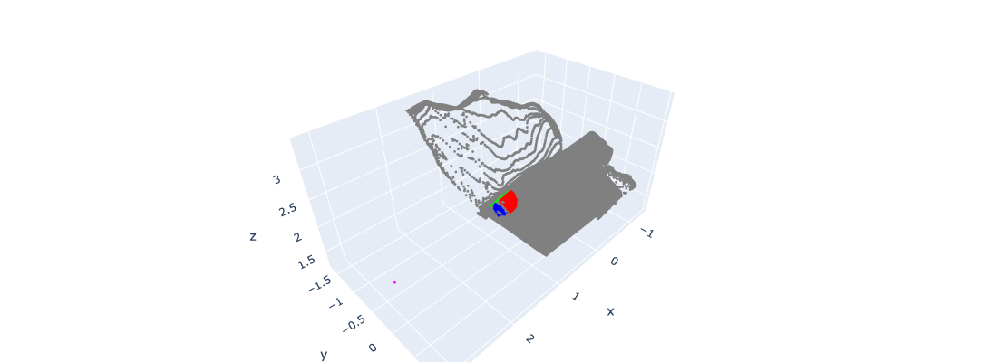

In [23]:
import open3d as o3d
import numpy as np



# 보정이 잘 안되었던 keypoint 시각화
k2 = pcd_true[28*192 + 94]
keypoint2 = o3d.geometry.PointCloud()
keypoint2.points = o3d.utility.Vector3dVector([k2])
keypoint2.paint_uniform_color([1, 0, 0])

planes, intersection_2 = adjust_coordinates(ply_path, k2)
intersection_point_2 = o3d.geometry.PointCloud()
intersection_point_2.points = o3d.utility.Vector3dVector([intersection_2])
intersection_point_2.paint_uniform_color([1, 0, 1])  




# 7. 각 평면을 시각화용 색상 설정
colors = [[1, 0, 0], [0, 1, 0], [0, 0, 1]]  # 빨강, 초록, 파랑

for i, plane in enumerate(planes):
    plane.paint_uniform_color(colors[i])


# 8. 원본 포인트 클라우드 색상 설정
pcd.paint_uniform_color([0.5, 0.5, 0.5])  # 회색

# 9. 시각화
o3d.visualization.draw_plotly([pcd] + planes + [intersection_point_2] + [keypoint2])